# Měření velikosti zahřívané součátky

Tento úkol je zaměřen na využití kombinace dat z obyčejné RGB kamery a termokamery. Jako zahřívaná součástka bylo využito zařízení **Raspberry Pi 2 (Model B)** společně s **parazitními 2A rezistory** připojeny v USB.

Úkol má za cíl oživit dovednosti studentů při práci s obrazem, jakými jsou například projektivní transformace, segmentace nejen v barevných kanálech nebo měření velikostí v reálných jednotkách.

![](images/vv.png)


### Import knihoven a konfigurace


In [ ]:
import os
import io

import cv2
import numpy as np
import matplotlib.pyplot as plt

from improutils import *
from scipy.spatial import distance

%matplotlib inline
np.set_printoptions(formatter={'float': lambda x: "{0:0.3f}".format(x)})

/shared-libs/python3.8/py/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/root/venv/lib/python3.8/site-packages/qrdet/qrdet.py:125: UserWarning: QRDetector has been updated to use the new YoloV8 model. Use legacy=True when calling detect for backwards compatibility with 1.x versions. Or update to new output (new output is a tuple of dicts, containing several new information (1.x output is accessible through 'bbox_xyxy' and 'confidence').Forget this message if you are reading it from QReader. [This is a first download warning and will be removed at 2.1]
  warn("QRDetector has been updated to use the new YoloV8 model. Use legacy=True when calling detect "


### Pomocné funkce

Seznamte se, lze využít. Ostatní již známé funkce jsou v [improutils](https://gitlab.fit.cvut.cz/bi-svz/improutils_package).


In [ ]:
def normalized_image(img):
    # Dejte si pozor, že cv2.normalize nalezne minimální/maximální hodnotu v obraze vůči kterým normalizuje a tento vstup nelze změnit.
    # Můžeme pouze nastavit nové minimum a maximum. Později v úkolu budete muset napsat svoji "chytřejší" normalizaci.
    scaled = np.zeros_like(img)
    cv2.normalize(img, scaled, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    return scaled.astype("uint8")


def to_3_channels(image_one_channel):
    """
    Převede jednokanálový obrázek na tříkanálový.
    Cílem je například přidat možnost do černobílého obrázku něco kreslit nebo spojovat více 3kanálových obrázků.
    """
    h, w = image_one_channel.shape
    image3 = np.zeros((h, w, 3), dtype=np.uint8)
    image3[:, :, 0] = image_one_channel
    image3[:, :, 1] = image_one_channel
    image3[:, :, 2] = image_one_channel
    return image3


def load_termo_csv(file_path):
    """
    Načtení dat z textového souboru do numpy matice. Textová data jsou oddělena pomocí znaku středník (;).
    """
    return np.genfromtxt(file_path, delimiter=";")[:, :-1]

---


## Úkol

K obrazové práci nad zahřívanou součástky jsou k dispozici nasnímaná data z rgb kamery a data reálných teplot z termokamery. Oboje je dostupné ve složce `data/`.

Za úkol je možné získat až **8 bodů** a až **2 prémiové**.


### 1) Načtěte data

Načtěte obrazová data ve formátu `png` a data teplot ve formátu `csv`. Data teplot obsahují reálné hodnoty teplot v jednotkách **°C** s přesností na desetinu stupně. Vhodně zobrazte jak data **obrazová**, tak data **teplot** obrázkem.

<div style="color: blue; text-align: right">[ 0,5 bodu ]</div>


(512, 640)

(1200, 1920, 3)

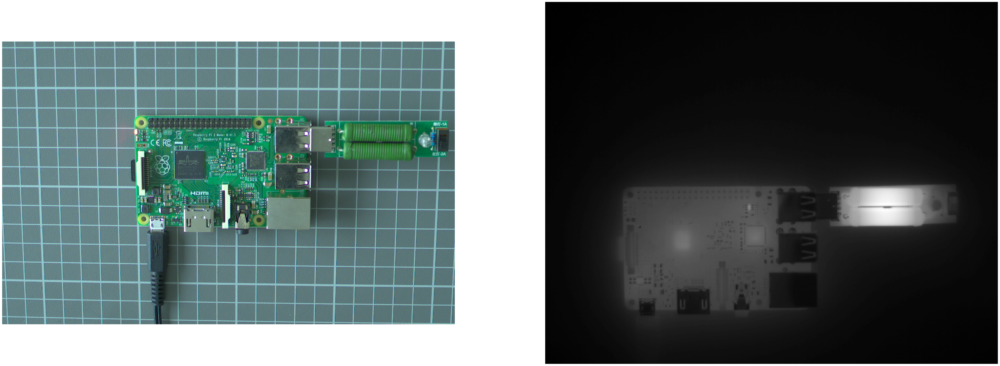

In [ ]:
img = load_image("data/data_rgb.png")
temp = load_termo_csv("data/data_temps.csv")
tempNorm = normalized_image(temp)
cv2.imwrite("data/tempNorm.png", tempNorm)
plot_images(img, tempNorm)
display(temp.shape, img.shape)

new_shape = img.shape[1::-1]

Colormaped

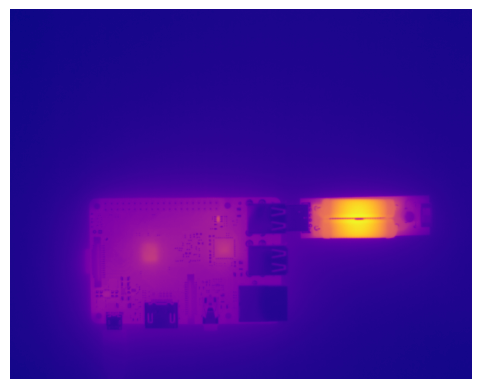

In [ ]:
plt.axis("off")
plot = plt.imshow(temp, cmap="plasma")

### 2) Vypište hodnoty několika teplot

Zvolte v obraze **3 body** a vypište hodnoty teploty v těchto bodech. Snažte se najít místa s **nejvyššími** teplotami.

<div style="color: blue; text-align: right">[ 0,5 bodu ]</div>


In [ ]:
idxs = np.unravel_index(np.argsort(temp, axis=None)[-3:], temp.shape)
for i in range(3):
    y, x = idxs[0][i], idxs[1][i]
    print(f"Max temp #{i + 1}: {temp[y, x]}°C at ({y}, {x})")

Max temp #1: 68.1°C at (285, 483)
Max temp #2: 68.1°C at (285, 479)
Max temp #3: 68.1°C at (294, 479)


### 3) Namapujte termosnímek na RGB

Uvědomte si, že snímky **nejsou stejně velké** ani foceny ze **stejného úhlu**. Pamatujte, že je **důležité** uvědomit si **správně rovinu**, ve které pracujeme. Zobrazte jak obrázek RGB, tak namapovaný termosnímek.

Klíčová slova:

- přiřazení dvojic bodů
- hledání transformační matice
- warpování termosnímku na perspektivu RGB

<div style="color: blue; text-align: right">[ 1,5 bodu ]</div>


Použil jsem všechny rohy desek. Tedy 4 rohy Rasberry pie a 4 rohy připojené desky s rezistory. Je to lehce nakřivo, ale close enough

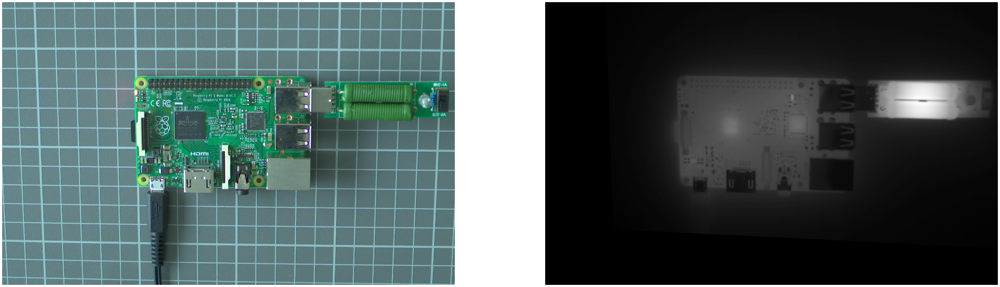

In [ ]:
rgb_points = np.array(
    [
        (567, 324),
        (1285, 325),
        (1369, 338),
        (1888, 337),
        (1883, 490),
        (1367, 491),
        (1305, 797),
        (578, 775),
    ]
)
temp_points = np.array(
    [
        (112, 266),
        (372, 263),
        (402, 262),
        (579, 258),
        (581, 312),
        (402, 317),
        (384, 431),
        (114, 432),
    ]
)
assert len(rgb_points) == len(temp_points)
M, _ = cv2.findHomography(temp_points, rgb_points)
tempNorm_warped = cv2.warpPerspective(tempNorm, M, new_shape)
plot_images(img, tempNorm_warped)

### 4) Segmentujte v termosnímku

Pomocí rozsahu **reálných teplot** (ne jasových hodnot) vytvořte binární masku, která bude obsahovat **celé Raspberry Pi** bez připojených USB rezistorů. Masku zobrazte.

<div style="color: blue; text-align: right">[ 1,5 bodu ]</div>


Pouze pomocí teploty se nedá oddělit základní deska od připojených rezistorů. Proto jsem danou část masky ořízl

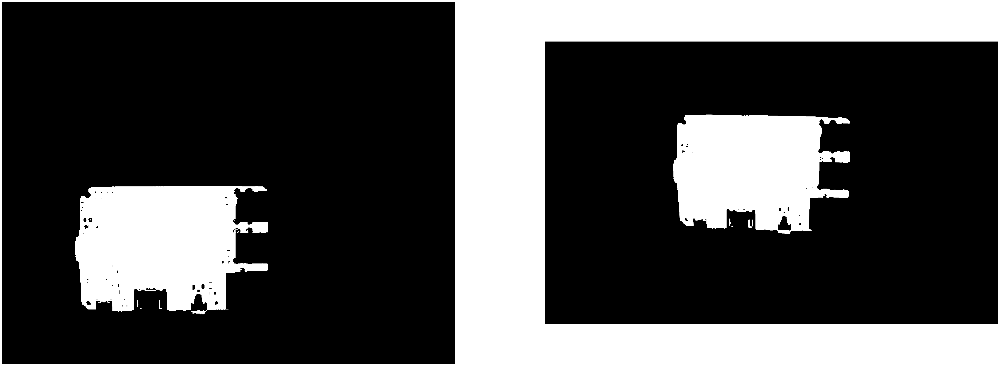

In [ ]:
threshold = 36
mask = np.zeros_like(temp)
mask[temp > threshold] = temp[temp > threshold]
mask[:, 380:] = 0
mask_warped = cv2.warpPerspective(mask, M, new_shape)
plot_images(mask, mask_warped)

### 5) Aplikujte data teplot na RGB obraz

Pomocí výše vytvořené **binární masky** segmentujte **data teplot**. Ty následně zobrazte pomocí vybrané [JET colormapy](https://docs.opencv.org/3.2.0/d3/d50/group__imgproc__colormap.html). Jako dílčí výstup **vytvořte funkci** pro **min-max normalizaci** teplotních hodnot obrazu, která přímá na vstupu **min, max, newmin, newmax**. Bude se hodit při aplikaci colormapy. Dále se vám může hodit funkce `to_3_channels()` k snadnějším bitovým operacím. Její využití však není podmínkou, způsobů získání výsledku je více.

Snímek by měl vypadat následovně (nenechte se zmást zobrazením BGR $\leftrightarrow$ RGB při používání matplotlibu).

![](images/fuse.png)

Klíčová slova:

- min-max normalizace
- aplikace colormapy
- segmentace pomocí masky
- vážené spojení dvou obrazů

<div style="color: blue; text-align: right">[ 1,5 bodu ]</div>


In [ ]:
# Min-max normalization from wiki https://en.wikipedia.org/wiki/Normalization_(image_processing)
def min_max_norm(image, min, max, newMin=0, newMax=255):
    return (image - min) * ((newMax - newMin) / (max - min)) + newMin

Chci použít pouze teploty z desky. Kde deska není, tam má maska hodnotu 0 a tudíž tyto hodnoty nechci zahrnovat do minima

48.9

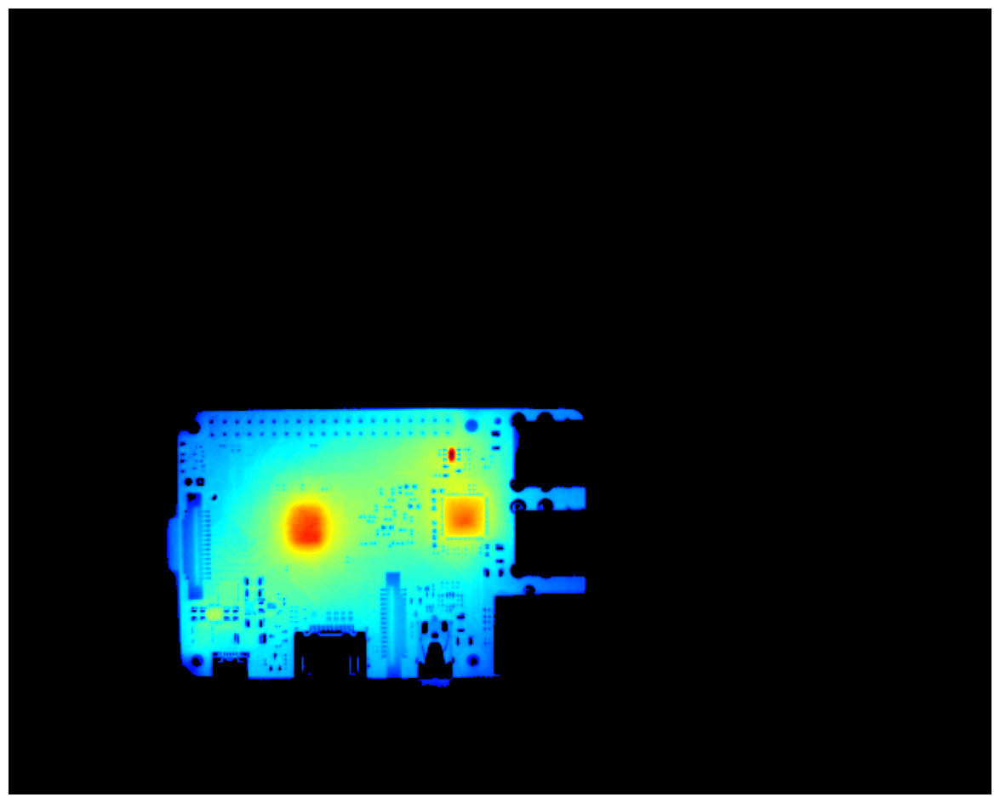

In [ ]:
segmented_temp = np.where(mask > 0, temp, 0)
normalized_temp = min_max_norm(
    segmented_temp,
    np.min(segmented_temp[segmented_temp > 0]),
    np.max(segmented_temp),
    np.min(segmented_temp[segmented_temp > 0]),
)
display(np.max(segmented_temp))
colored = cv2.applyColorMap(to_3_channels(normalized_temp), 2)
colored = np.where(segmented_temp[:, :, np.newaxis] > 0, colored, 0)
plot_images(colored)

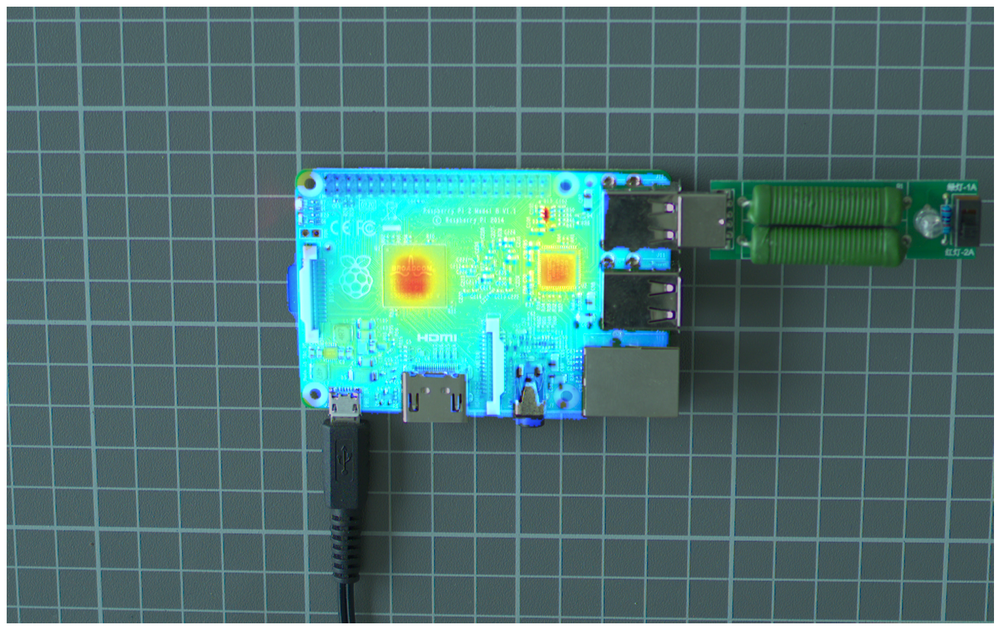

In [ ]:
colored_warped = cv2.warpPerspective(colored, M, new_shape)
combined = cv2.addWeighted(img, 0.75, colored_warped, 0.75, 0)
plot_images(combined)

### 6) Segmentujte součástky

Využijte teplotní data k segmentaci **pouze 2 zahřívajících se** součástek - mikročipů. Zajímá nás plocha, která má teplotu vyšší než **43 °C**.

Při jejich hledání **využijte** informaci, že hledané mikročipy mají přibližně tvar čtverce.

<div style="color: blue; text-align: right">[ 1,5 bodu ]</div>


Jelikož hodnota v pixelu je ve skutečnosti teplota, můžu použít tuto segmentaci (předtím mě to nenapadlo)

2

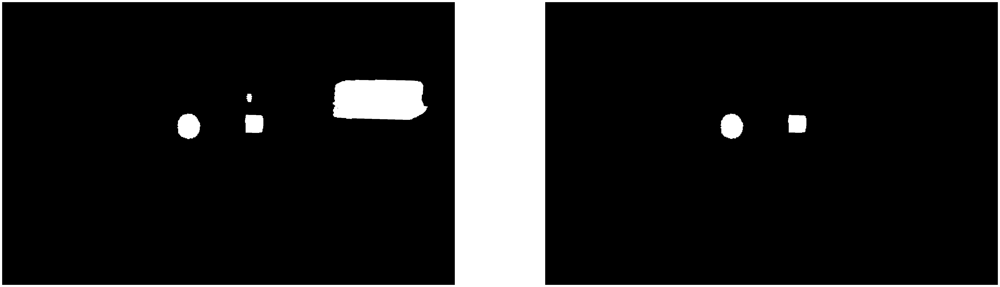

In [ ]:
hothot = segmentation_one_threshold(temp, 43)
microChips_warped = cv2.warpPerspective(hothot, M, new_shape)
cont, n, contours = find_contours(cv2.convertScaleAbs(microChips_warped), 1000, 8000)
plot_images(microChips_warped, cont)
n

In [ ]:
# https://theailearner.com/tag/cv2-minarearect/
rect_right, rect_left = cv2.minAreaRect(contours[0]), cv2.minAreaRect(contours[1])
box_right = np.int0(cv2.boxPoints(rect_right))
box_left = np.int0(cv2.boxPoints(rect_left))

Je to nakřivo (není to tak hrozné :clueless:). Dalo by se to možná spravit tím, že bych zkusil přepsat pár bodů pro warpování perspektivy, ale již jsem to párkrát předělával a tohle je asi nejlepší, takže to tam už nechám.


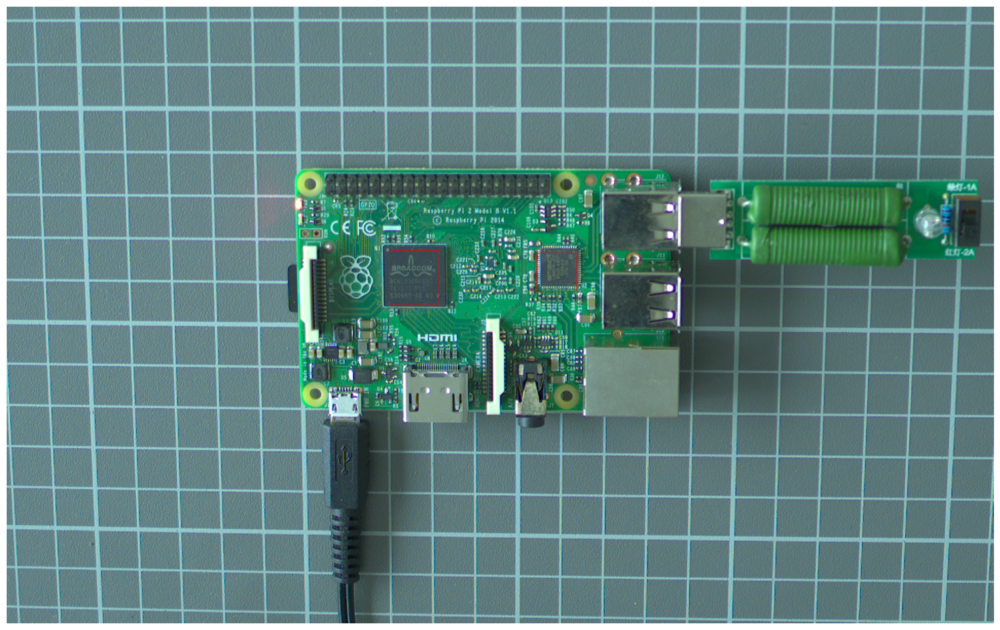

In [ ]:
rectangeles = cv2.drawContours(img.copy(), [box_right], 0, (0, 0, 255), 1)
rectangeles = cv2.drawContours(rectangeles, [box_left], 0, (0, 0, 255), 1)
plot_images(rectangeles)

### 7) Zjistěte velikost mikročipů v reálných jednotkách

Zjistěte pro každý mikročip, jak velká je celková zahřívaná plocha v $cm^2$ mající vyšší teplotu než je pro nás kritických **43 °C**. Pro přechod z pixelů do reálných jednotek jsme důkladně cvičili 2 různé způsoby. V tomto případě, je ale jeden z nich správnější, než ten druhý. Vyberte, který chcete, o absolutní přesnost zde v tuhle chvíli nejde. Disktutujte však správnost vybraného postupu.,

**HINT -** Perspektiva.

<div style="color: blue; text-align: right">[ 1 bod ]</div>


Použil jsem čtvercovou síť na pozadí. Předpokládám, že jeden malý čtvereček má 1x1 cm. Namapuji si obrátek tak, aby měl jeden čtvereček 100x100 pixelů (ve skutečnosti jsem použil 5x5 čtverečeků, jelikož mi to jinak nějak blblo). Další možnost by byla si najít rozměry konkrétního modelu Rasberry Pi, ale nepřijde mi, že to je něco, co bychom měli dělat.

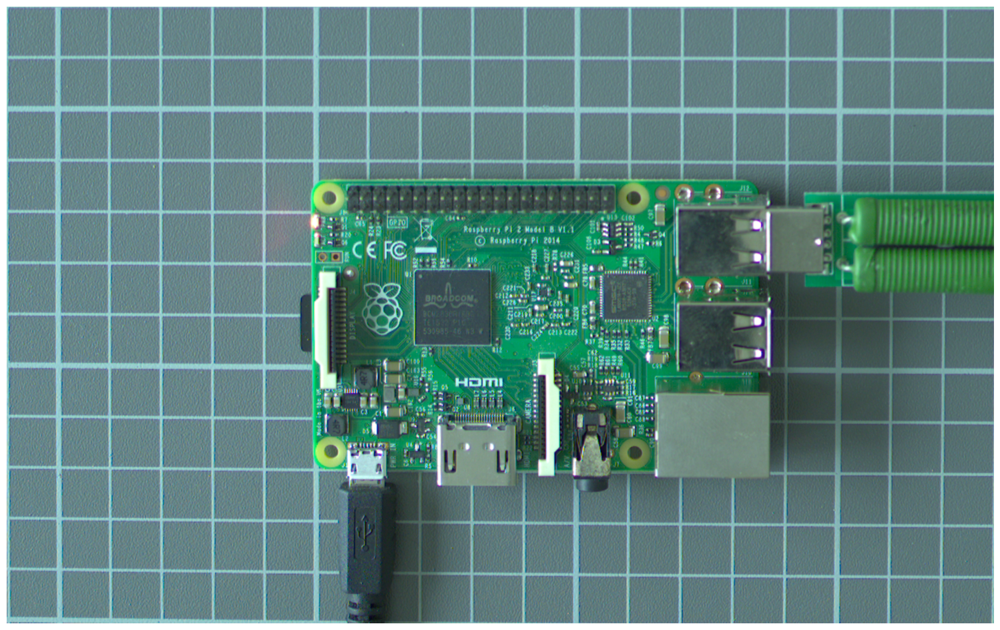

In [ ]:
# show_images(img)
src_pts = np.array([(54, 28), (477, 28), (486, 452), (70, 451)])
dst_pts = np.array([(0, 0), (5 * 100, 0), (5 * 100, 5 * 100), (0, 5 * 100)])
M2, _ = cv2.findHomography(src_pts, dst_pts)
check = cv2.warpPerspective(img, M2, new_shape)
plot_images(check)

To samé co předtím, jen na narovnaném obrázku


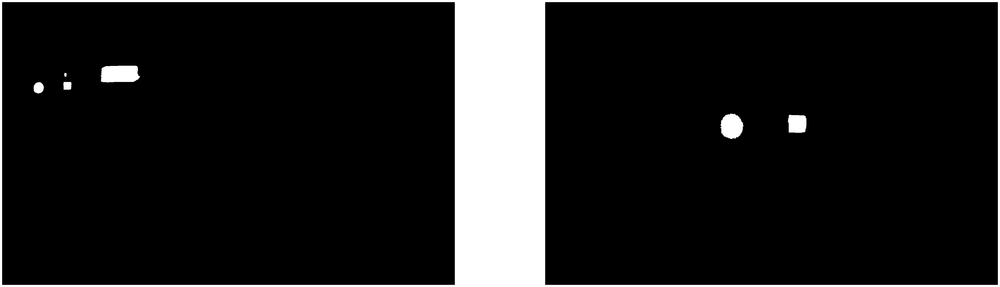

In [ ]:
microChips_warped2 = cv2.warpPerspective(hothot, M2, new_shape)
cont, n, contours = find_contours(cv2.convertScaleAbs(microChips_warped), 1000, 8000)
plot_images(microChips_warped2, cont)

Velikosti mi vyšly o něco menší, než bych odhadem čekal, ale snad to není vyloženě špatně

In [ ]:
_, size_right, _ = cv2.minAreaRect(contours[0])
_, size_left, _ = cv2.minAreaRect(contours[1])
display(size_right, size_left)
print(f"Velikost levého čipu je cca {size_left[0]*size_left[1]/100**2} cm\u00b2")
print(f"Velikost pravého čipu je cca {size_right[0]*size_right[1]/100**2} cm\u00b2")

(75.0, 77.0)

(106.0, 96.0)

Velikost levého čipu je cca 1.0176 cm²
Velikost pravého čipu je cca 0.5775 cm²


---


### 8) Prémium #1

Nabízím 1 prémiový bod za detekci středů kružnic v RGB i v termo automatizovaně pomocí algoritmů. Například pomocí Houghovy transformace nebo i třeba hranové detekce + tvarových charakteristik. Jde primárně o díry na šrouby, které lze využít k hledání korespondenčních bodů a následné aplikaci perspektivní transformace.

### 9) Prémium #2

Nabízím 1 prémiový bod za výpočet plochy v cm$^2$ obou mikročipů v RGB obraze. Následně je nutné výsledky dát do poměru s vypočtenou plochou z termo snímku, která se zahřívala nad kritických 43° C. Tím lze například porovnat, který z nich se více zahřívá.


<a style='text-decoration:none;line-height:16px;display:flex;color:#5B5B62;padding:10px;justify-content:end;' href='https://deepnote.com?utm_source=created-in-deepnote-cell&projectId=43a4a47a-aebc-4ef3-9d42-dc6c14f1509d' target="_blank">
 </img>
Created in <span style='font-weight:600;margin-left:4px;'>Deepnote</span></a>